C:\Users\CATALINA ESPINOZA\AppData\Local\conda\conda\envs\env27\lib\site-packages\nbconvert\exporters\exporter_locator.py:28: DeprecationWarning: `nbconvert.exporters.exporter_locator` is deprecated in favor of `nbconvert.exporters.base` since nbconvert 5.0.
  DeprecationWarning)
C:\Users\CATALINA ESPINOZA\AppData\Local\conda\conda\envs\env27\lib\site-packages\nbconvert\preprocessors\regexremove.py:41: DeprecationWarning: Traits should be given as instances, not types (for example, `Int()`, not `Int`). Passing types is deprecated in traitlets 4.1.
  patterns = List(Unicode, default_value=[r'\Z']).tag(config=True)
C:\Users\CATALINA ESPINOZA\AppData\Local\conda\conda\envs\env27\lib\site-packages\traitlets\traitlets.py:2367: DeprecationWarning: Traits should be given as instances, not types (for example, `Int()`, not `Int`). Passing types is deprecated in traitlets 4.1.
  super(Set, self).__init__(trait, default_value, minlen, maxlen, **kwargs)
C:\Users\CATALINA ESPINOZA\AppData\Local\con


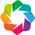

In [1]:
from __future__ import division
import string
import math
import pandas as pd 
import numpy as np
import seaborn as sns
import nltk
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt, mpld3
import matplotlib.pylab as pylab
mpld3.enable_notebook()
import json
import unidecode
from scipy import stats
import holoviews as hv
hv.extension('bokeh')

C:\Users\CATALINA ESPINOZA\AppData\Local\conda\conda\envs\env27\lib\site-packages\pydub\utils.py:165: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)



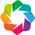

In [2]:
import pickle
import os
from nltk import sent_tokenize
from transcription_manager import evaluacion_docente_manager as edm
from text_clustering import text_preprocessing as tp, word_connection_matrix as wcm, viz

In [3]:
# importar base de datos de audios (excel)
path_clusters = 'C:\Users\CATALINA ESPINOZA\Documents\clusters ciae'
path_data = os.path.join(path_clusters,'data')
path_db = os.path.join(path_data,'transcrip')
path_pickle = os.path.join(path_clusters,'output','pickles')

In [4]:
FILTER_STOP_WORDS = True

## Recover data

In [5]:
with open(os.path.join(path_pickle,'dialog_tuples.pickle'),'rb') as f:
    dialog_tuples = pickle.load(f)

In [6]:
dialog_tuples[10]

('4_0',
 datetime.time(0, 36, 21),
 u'profesor',
 'todos',
 'pregunta',
 u'mat',
 u'c\xf3mo saber qu\xe9 parte de un entero corresponde a una fracci\xf3n determinada o  por ejemplo, la pregunta que ten\xedamos ac\xe1, c\xf3mo podr\xedamos ir haciendo un resumen de lo aprendido.. qu\xe9 fue lo que aprendimos hoy?')

In [7]:
clean_x = lambda x: str(x) if type(x) == int or type(x) == float else x.encode('utf-8')

In [8]:
all_documents_dict = dict((str(x)+'_'+'_'.join([str(y),clean_x(z),edm.get_to_whom(clean_x(a)),edm.get_type_of_speech(clean_x(b)),clean_x(c)]), clean_x(d).decode('utf8')) for x,y,z,a,b,c,d in dialog_tuples)

In [9]:
token_set = tp.get_all_token_set(all_documents_dict)
print(len(token_set))

7845


In [10]:
frequency_per_word = tp.get_frequency_per_word(all_documents_dict,token_set)
zipped = zip(token_set,frequency_per_word)
zipped.sort(key = lambda t: t[1], reverse=True)

In [11]:
# TODO: ver que hace tokenize porque no entiendo como cambia tanto el resultado de las palabras 
# mas frecuentes
print("N, Palabra, Frecuencia ")
for i in range(len(zipped)):
    if i<400:
        print str(i)+"- "+clean_x(zipped[i][0])+" - "+str(repr(zipped[i][1]).encode('utf8'))

N, Palabra, Frecuencia 
0- , - 11848
1- que - 3467
2- de - 3369
3- la - 3260
4- a - 3133
5- y - 2729
6- el - 2673
7- ? - 2464
8- . - 2026
9- en - 1675
10- es - 1560
11- lo - 1236
12- un - 1179
13- los - 1115
14- por - 1086
15- ya - 996
16- qué - 976
17- una - 975
18- vamos - 929
19- se - 923
20- no - 819
21- con - 812
22- dos - 794
23- para - 788
24- las - 743
25- ¿ - 700
26- más - 610
27- ustedes - 607
28- ( - 575
29- si - 574
30- ) - 573
31- bien - 551
32- entonces - 524
33- yo - 506
34- me - 486
35- .. - 479
36- o - 450
37- tres - 416
38- tiene - 409
39- ahora - 403
40- ahí - 403
41- uno - 402
42- está - 390
43- del - 381
44- tenemos - 373
45- van - 360
46- son - 358
47- cierto - 355
48- clase - 351
49- este - 350
50- eso - 349
51- esta - 345
52- al - 345
53- les - 341
54- cuatro - 334
55- aquí - 325
56- hacer - 324
57- hay - 320
58- va - 317
59- cómo - 300
60- pero - 299
61- como - 299
62- ver - 289
63- … - 287
64- nosotros - 281
65- porque - 276
66- menos - 273
67- acá - 272
68- c

## Filter words

In [12]:
all_documents_dict

{'262_13_00:00:00_silencio_silencio_nan_haciendo actividad': u'nan',
 '318_7_00:00:00_profesor_estudiante_pregunta_mat': u'\xbfs\xed?',
 '35_17_00:36:23_silencio_silencio_nan_haciendo actividad': u'nan',
 '135_27_00:10:00_silencio_silencio_nan_haciendo actividad': u'nan',
 '134_12_00:10:00_profesora_todos_pregunta_haciendo actividad': u'ya, entonces.. No quiero que se corra esto. Por la punta. Ya ni\xf1itas, tenemos que\u2026 \xbfcu\xe1nto me dijeron que era?',
 '129_25_00:00:00_alumna5_profe_respuesta_mat': u'denominador',
 '700_7_00:36:00_alumno4_profe_respuesta_mat': u'buena, pude (..) ',
 '128_11_00:30:00_alumno3_profe_pregunta_mat': u'(\u2026)',
 '637_4_00:00:00_profe_todos_afirmacion_disciplina': u'pueden sentarse ',
 '123_4_00:31:27_profesora_todos_pregunta_mat': u'y alguien me podr\xeda indicar (\u2026.) todos los (..), y ah\xed nosotros hemos concluido que per\xedmetro es la suma de los lados de un pol\xedgono, yo quiero que ustedes ahora que me digan si entendieron o aprendie

In [13]:
set_300_most_frequent = tp.get_filter_by_number(token_set,frequency_per_word,100,FILTER_STOP_WORDS)

In [14]:
reload(tp)
set_300_most_frequent

[u'?',
 u'vamos',
 u'dos',
 u'ustedes',
 u'si',
 u'bien',
 u'entonces',
 u'tres',
 u'ahora',
 u'ah\xed',
 u'van',
 u'cierto',
 u'clase',
 u'cuatro',
 u'aqu\xed',
 u'hacer',
 u'va',
 u'c\xf3mo',
 u'ver',
 u'menos',
 u'ac\xe1',
 u'cinco',
 u'hoy',
 u'cu\xe1nto',
 u'aver',
 u'voy',
 u'cada',
 u'n\xfamero',
 u'd\xeda',
 u'dice',
 u'igual',
 u'seis',
 u'per\xedmetro',
 u'fracci\xf3n',
 u'cuadrado',
 u'ser',
 u'x',
 u'lados',
 u'puede',
 u'grupo',
 u'cu\xe1l',
 u'figura',
 u'ciento',
 u'despu\xe9s',
 u'ejemplo',
 u'fracciones',
 u'ocho',
 u'trabajar',
 u'\xe1rea',
 u'mismo',
 u'forma',
 u'n\xfameros',
 u'parte',
 u'decir',
 u'qui\xe9n',
 u'mil',
 u'problema',
 u'tener',
 u'coma',
 u'gu\xeda',
 u'tri\xe1ngulo',
 u'partes',
 u'diez',
 u'trabajo',
 u'cu\xe1ntos',
 u'podemos',
 u'pueden',
 u'objetivo',
 u'lado',
 u'pregunta',
 u'usted',
 u'valor',
 u'd\xedas',
 u'primero',
 u'siete',
 u'calcular',
 u'claro',
 u'medio',
 u'cantidad',
 u'pesos',
 u'ecuaci\xf3n',
 u'alguna',
 u'as\xed',
 u'cero',
 

### Build matrices with the pair of words frequency per session

In [15]:
matrices_list,names_matrices = wcm.get_matrices(all_documents_dict,set_300_most_frequent)
print(len(matrices_list))

6017


In [16]:
matrix_example = pd.DataFrame(matrices_list[0])
matrix_example.columns = set_300_most_frequent
matrix_example.index = set_300_most_frequent
matrix_example

,?,vamos,dos,ustedes,si,bien,entonces,tres,ahora,ahí,...,problemas,resolver,cuarenta,rectángulo,cuarto,nueve,ir,quiero,gráfico,entero
?,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
vamos,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
dos,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ustedes,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
si,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
bien,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
entonces,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
tres,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ahora,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ahí,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [17]:
norm_array_list = map(lambda x: np.ravel(x),matrices_list)

## Clustering matrices

### Kmeans Clustering

(array([5902.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
         115.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

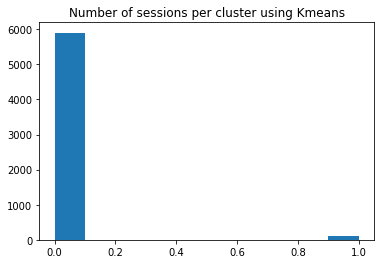

In [18]:
n_kmeans = 2
centers_kmeans,labels_kmeans = wcm.get_kmeans_clusters(norm_array_list,n_kmeans)
plt.title("Number of sessions per cluster using Kmeans")
plt.hist(labels_kmeans)

In [19]:
kmeans_axis = centers_kmeans[1] - centers_kmeans[0]
kmeans_indicator_matrices = map(lambda x: np.dot(x,kmeans_axis),norm_array_list) 

### SVM Clustering

(array([ 248.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        5769.]),
 array([-1. , -0.8, -0.6, -0.4, -0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ]),
 <a list of 10 Patch objects>)

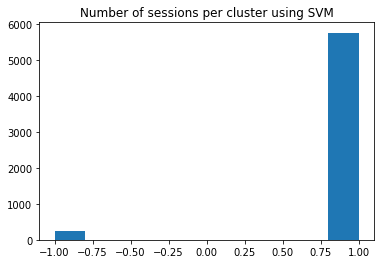

In [20]:
centers_svm,labels_svm = wcm.get_svm_clusters(norm_array_list)
plt.title("Number of sessions per cluster using SVM")
plt.hist(labels_svm)

In [21]:
svm_axis = centers_svm[1] - centers_svm[0]
svm_indicator_matrices = map(lambda x: np.dot(x,svm_axis),norm_array_list)

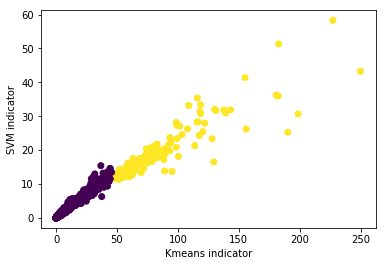

In [22]:
plt.scatter(kmeans_indicator_matrices,svm_indicator_matrices,c=labels_kmeans)
plt.ylabel("SVM indicator")
plt.xlabel("Kmeans indicator")
plt.show()

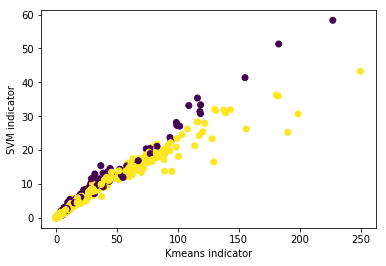

In [23]:
plt.scatter(kmeans_indicator_matrices,svm_indicator_matrices,c=labels_svm)
plt.ylabel("SVM indicator")
plt.xlabel("Kmeans indicator")
plt.show()

### Painting by time period

In [24]:
names_matrices[0]

'262_13_00:00:00_silencio_silencio_nan_haciendo actividad'


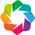

<module 'text_clustering.viz' from 'text_clustering\viz.pyc'>

In [25]:
reload(viz)

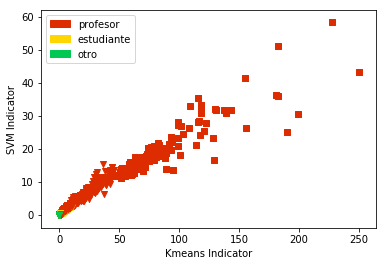

In [26]:
viz.scatter_plot_by_who_by_cluster(kmeans_indicator_matrices,svm_indicator_matrices,labels_kmeans,'Kmeans Indicator','SVM Indicator',names_matrices,'upper left')

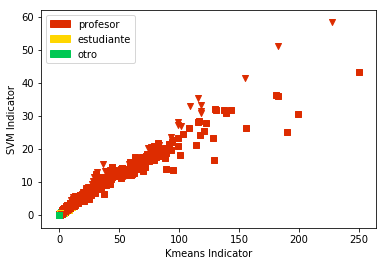

In [27]:
viz.scatter_plot_by_who_by_cluster(kmeans_indicator_matrices,svm_indicator_matrices,labels_svm,'Kmeans Indicator','SVM Indicator',names_matrices,'upper left')

### KS matrix

In [28]:
%%opts HeatMap [tools=['hover'] colorbar=True width=1000 height=1000 toolbar='above']
ks_matrix,w_ij_cluster0,w_ij_cluster1 = viz.get_ks_matrix(labels_kmeans,norm_array_list,set_300_most_frequent)
heatmap = viz.ks_heatmap(ks_matrix,w_ij_cluster0,w_ij_cluster1,set_300_most_frequent)
heatmap

:HeatMap   [x,y]   (KS,freq_in_documents_and_by_minute_cluster_0,freq_in_documents_and_by_minute_cluster_1)